<a href="https://colab.research.google.com/github/russelljjarvis/LIF_DE_Brian2/blob/main/_Brian2DiffEquations_used.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

<h1 align="center">
Tutorial on the Leaky Integrate and Fire model in Python.

Russell Jarvis (PhD Computational Neuroscience Arizona State University).

R.Jarvis@westernsyndney.edu.au

<img src='https://github.com/neuromorphicsystems/MoNE_LIF_Model/blob/main/figs/wsu_brand.jpg' width="750">
</h1>

<h1 align="center"> Scope of Tutorial </h1> 

<h1 align="center">

<img src='figs/intro_scope.jpg' width="750">
</h1>


## Assumed Knowledge (Pre-requisites)

* Parallel RC circuits
* Membrane bilayer
* Ionic basis of the membrane potential
* Programming with either Python, MATLAB, C or NEURON or any procedural language.

## In this tutorial we will:
- Model the electrical behavior of LIF neurons (in-code)
- Learn (or revise) Python 
- Introduce and Use Google colabatory notebooks (colab)
- Solve the LIF neuron with forward Euler method in Python
- Solve the LIF neuron with Brian2 (Python module)

## Google Colaboratory
* Cloud Environment
* Highly reproducible (If code runs for you it runs for everyone). 
* Nothing persists between sessions, when you logout of the browser tab, everything starts from scratch
* It is a Python platform that can also render HTML and $ \LaTeX $ 

<h1 align="center"> Reduced Neuron Models </h1>

<h1 align="center">
<img src="figs/neurons.jpg" width="650" />
</h1>

<h1 align="center">
<img src="https://upload.wikimedia.org/wikipedia/commons/b/b6/Cajal_Retina.jpg" />
<img src="https://upload.wikimedia.org/wikipedia/commons/1/15/PurkinjeCell.jpg" />
</h1>
Source: Wikipedia

<h1 align="center">
<img src="figs/passive_memb.png" width="750" />
</h1>

<h1 align="center">
<img src="figs/passive_memb_eq.png" width="750"/>
</h1>

## The equilibrium potential
Nernst equation:

$$E_{ion}=\frac{RT}{z_{ion}F}ln\frac{[X]_{out}}{[X]_{in}}$$

However, membrane potential is permeable to multiple types of ions. Solution is to use Goldman–Hodgkin–Katz (GHK) current equation:

$$E_m=\frac{RT}{F}ln\frac{P_K[K^+]_{out}++P_{Na}[Na^+]_{out}+P_{Cl}[Cl^-]_{in}}{P_K[K^+]_{in}+P_{Na}[Na^+]_{in}+P_{Cl}[Cl^-]_{out}}$$

## Hodgkin-Huxley Model

<img src="figs/HH.png" width="250" />
source: Schwiening, C. J. (2012).
<h1 align="center"> <img src="figs/HH_eq1.png" width="400" />
<img src="figs/HH_eq2.png" width="400" />
</h1>
source: Hodgkin, A. L., & Huxley, A. F. (1952).

<h1 align="center">
<img src="figs/action_potential.png" width="450" />
</h1>

## Simplification of the electrical circuit
### Kirchofs current law
“The algebraic sum of all currents entering and exiting a node must equal zero” -- current is conserved.

<h1 align="center">
<img src="figs/lumped_params.jpg" width="750" />
</h1>
<h1 align="center">
<img src="figs/ignore_for_now.png" width="650" />
</h1>

<h1 align="center">
<img src="figs/lif_eq.png" width="450" />
</h1>

<h1 align="center">
<img src="figs/lif_model.png" width="650" /> 
</h1>


<h1 align="center"> Towards Executing the LIF Model as Code </h1>

## Digital Simulation as a Biological Experiment

<h1 align="center">
    <img src="figs/virtual_experiment.png" width="350" />
</h1>

**2 ways to implement the LIF as code.**  
1. Simply declare the Differential Equation as a string, and offload solving the equation to an automatic ODE solver like Brian2.
2. Use Discrete time integration aka the forward Euler method, in which case we need a particular discrete version of the LIF equation.



\begin{eqnarray}
 \tau_{m} \frac{dV}{dt} = - [V(t)-E_{L}] +RI(t) 
 \end{eqnarray}

\begin{eqnarray}
 y_{n+1} = y_{n} + hf(x_{n},y_{n}) 
\end{eqnarray}

\begin{eqnarray}
 V_{N+1} = V_{N}+\Delta t F(t_{N},V_{N}) 
 \end{eqnarray}




# Simplifying Complexity.

<h1 align="center">
<img src="figs/reduction_to_lif.png" width="450" />
</h1>

<h3 align="center">
  From multi compartments to single compartment.
</h3>

* When you have a single compartment, it is more computationally tractable to simulate, and you can model it as a single RC circuit.
*  We are simplifying the biophysics of single cells, because we are more more focused on conserving computational power for large scale network level computations. We are more interested in harnessing the way neurons interact with each other. We want to harness neural network level interactions for the purposes of learning and computing.

<h1 align="center">
<img src="figs/reduction_to_lif2.gif" width="450" />
</h1>

### Now Begins Code

In [1]:
!pip install pandas -q
!pip install brian2 -q
!pip install plotly -q
!pip install ipywidgets -q
!pip install allensdk -q
!pip install quantities -q
!pip install neo -q

ERROR: Could not install packages due to an OSError: [Errno 2] No such file or directory: '/home/pablo/miniconda3/envs/teili_dev/lib/python3.7/site-packages/MarkupSafe-1.1.1.dist-info/METADATA'

^C
ERROR: Operation cancelled by user


In [ ]:
import os
if not os.path.exists("neurpynamics"):
  os.system("git clone https://github.com/DiGyt/neuropynamics/")


In [ ]:
from brian2 import *
import quantities as qt
import plotly
from brian2 import NeuronGroup, SpikeMonitor, StateMonitor, run
from brian2.units import ms
import plotly.express as px
import pandas as pd
import matplotlib.pyplot as plt
import os
from plotly.subplots import make_subplots
import plotly.graph_objects as go
import numpy as np
# Brian2 package
# Unit definitions
from brian2 import mV, ms, volt, second, umetre, ufarad, siemens, cm, msiemens, amp, uA, nA
# Other stuff
from brian2 import start_scope, NeuronGroup, StateMonitor, SpikeMonitor, run
# Plotting stuff
from brian2.units import mohm,nF, Mohm,ufarad,umetre,nS


from neuropynamics.src.utils.plotting import plot_single_neuron
# Interactive widgets
import ipywidgets as widgets
from ipywidgets import interact, interactive, fixed, HBox, VBox, Layout
from allensdk.core.cell_types_cache import CellTypesCache
import matplotlib.pyplot as plt
import neo
import quantities as qt

#widget configurations:

# Set button layout
button_layout = Layout(width='180px', height='30px')

# Set slider config
slider_total_width = '800px'
slider_desc_width = '200px'

<!--# From Neuromatch academy:

In the next exercises, we will simulate the evolution of the membrane equation in discrete time steps, with a sufficiently small $\Delta t$.
-->

We can write the time derivative $ \frac{dV(t)}{dt}$ in the membrane equation without taking the limit $\Delta t \to 0$:

\begin{eqnarray}
 \tau_{m} \frac{dV}{dt} = - [V(t)-E_{L}] +RI(t) 
\end{eqnarray}

<!--
\begin{align*}
\\
\tau_m\,\frac{V\left(t+\Delta t\right)-V\left(t\right)}{\Delta t} &= E_{L} - V(t) + R\,I(t) \qquad\qquad (1)\\
\\
\end{align*}
-->
<summary> </summary>

<details>  
The value of membrane potential $V\left(t+\Delta t\right)$ can be expressed in terms of its previous value $V(t)$ by simple algebraic manipulation. 

For **small enough* *values of $\Delta t$, this provides a good approximation of the continuous-time integration.
</details> 
<!--
<summary> </summary>

<details>  

This operation is an integration since we obtain a sequence $\{V(t), V(t+\Delta t), V(t+2\Delta t),...\}$ starting from the ODE. Notice how the ODE describes the evolution of $\frac{d}{dt}\,V(t)$, the derivative of $V(t)$, but not directly the evolution of $V(t)$. For the evolution of $V(t)$ we need to integrate the ODE, and in this tutorial, we will do a discrete-time integration using the Euler method. See [Numerical methods for ordinary differential equations](https://en.wikipedia.org/wiki/Numerical_methods_for_ordinary_differential_equations) for additional details.

</details> 
-->




### <summary> Recall that $\Delta V$ is a small change in voltage. $\Delta t$ a small change in t </summary>

<details>
<h1 align="center">

  <img src="https://github.com/russelljjarvis/LIF_DE_Brian2/blob/main/other_lecture/compartments/avroc.png?raw=1" width="450" height="350" />
</h1>
</details>

We start by writing the time derivative $ \frac{dV(t)}{dt}$ in the membrane equation without taking the limit $\Delta t \to 0$:

<!--
* Explain with Picture Firing rate.
* Why use tau to for implementing LIF in IC.
-->

<!--# From Neuromatch academy:

# Simulating membrane potential
Compute the values of $V(t)$ between $t=0$ and $t=0.01$ with step $\Delta t=0.001$ and $V(0)=E_L$.


We need to reorganize the Eq. (1) to isolate $V\left(t+\Delta t\right)$ on the left side, and express it as function of $V(t)$ and the other terms:

$$V(t + \Delta t) =  V(t) + \frac{\Delta t}{\tau_m}(E_l -V(t) + R I(t))$$
-->



<!--
$
\begin{eqnarray}
 \tau_{m} \frac{dV}{dt} = - [V(t)-V_{L}] +RI(t) 
 \end{eqnarray}
(1.5)
$
For example: $\Delta t$ = 0.25ms

If we have a time-grid of of stepsize $\Delta t$.

$V_{n} = V(t=n)$

\begin{eqnarray}
\tau_m \frac{\Delta V_n}{\Delta t} &=& -(V_n-V_L) +\frac{I_n}{g_L},
\end{eqnarray}

where $V_n = V(n\Delta t)$, and $I_n=I(n\Delta t)$. 

Then the updating process of $V_{n+1}$ at time $t_{n+1}=(n+1)\Delta t$ based on $V_{n}$ can be formed as 
-->
\begin{eqnarray}
 \tau_{m} \frac{dV}{dt} = - [V(t)-V_{L}] +RI(t) 
 \end{eqnarray}

### Try to implement in code:
\begin{eqnarray}
\Delta V_n &=&  \left(-(V_n-V_L) +\frac{I_{n}}{g_L}\right)\frac{\Delta t}{\tau_m} \\ 
V_{n+1} &=& V_n+ \Delta V_n \\
\end{eqnarray}




# Now an executable model in code:
I have deliberately left some code out as an exercise for students.

In [ ]:

def forward_euler(Lt,V_reset,E_L,rec_spikes,tref,dt,Iinj,tau_m,g_L,tr,V_th):  
    """
    Simulate the LIF dynamics with external input current
    Args:
    dt is the simulation time step

    Returns: membrane potential v, and spike train rec_spikes.

    """
    v = np.zeros(Lt)
    
    
    for n in range(Lt-1):
      
      if tr > 0:  # check if in refractory period
        v[n] = V_reset  # set voltage to reset
        tr = tr - 1 # reduce running counter of refractory period

      elif v[n] >= V_th:  # if voltage over threshold
        rec_spikes.append(n)  # record spike event
        v[n] = V_reset  # reset voltage

        tr = tref / dt  # set refractory time
      # Calculate the increment of the membrane potential
      '''
      Try to implement forward Euler in code here.
      '''
      f_n = (-(v[n]-E_L) + (Iinj[n]/g_L))*1.0/tau_m
      v[n + 1] = v[n] + dt * f_n




    # Update the membrane potential
    # Get spike times in ms
    rec_spikes = np.array(rec_spikes) * dt
      
    return (v, rec_spikes)



# <summary>Code Hint 1</summary>
<details>

Something in the form of:

```python
      dv = ...
      v[n + 1] = ...

```
</details>

# <summary>Code Hint 2</summary>
<details>

```python
      f_n = (-(v[...]-...) + (Iinj[...]/...))*.../...)
      v[n + 1] = v[n] + ...

```
</details>

# <summary>Code Hint 3</summary>


<details>

#### <summary>Dont give up you might be close!</summary>
<details>

```python
      f_n = (-(v[n]-E_L) + (Iinj[n]/g_L))*1.0/tau_m
      v[n + 1] = v[n] + dt * f_n


```
</details>

</details>

In [ ]:

def run_LIF(pars, Iinj, sqaure_pulse=True):
  """
  Simulate the LIF dynamics with external input current
  Args:
    pars       : parameter dictionary
    Iinj       : input current [pA]. The injected current here can be a value
                 or an array
    stop       : boolean. If True, use a current pulse
  Returns:
    rec_v      : membrane potential
    rec_sp     : spike times
  """

  # Set parameters
  V_th, V_reset = pars['V_th'], pars['V_reset']
  tau_m, g_L = pars['tau_m'], pars['g_L']
  V_init, E_L = pars['V_init'], pars['E_L']
  dt, range_t = pars['dt'], pars['range_t']
  Lt = range_t.size
  tref = pars['tref']

  # Initialize voltage
  v = np.zeros(Lt)
  v[0] = float(V_init)

  # Set current time course
  Iinj = float(Iinj) * np.ones(Lt)

  # If current pulse, set beginning and end to 0
  if sqaure_pulse:
    Iinj[:int(len(Iinj) / 2) - 1000] = 0
    Iinj[int(len(Iinj) / 2) + 1000:] = 0


  # Loop over time
  rec_spikes = []  # record spike times
  tr = 0.  # the count for refractory duration
  (v, rec_spikes) = forward_euler(Lt - 1,V_reset,E_L,rec_spikes,tref,dt,Iinj,tau_m,g_L,tr,V_th)
  pars['Iinj'] =  Iinj
  return (v, rec_spikes,pars)



In [ ]:

def default_pars(**kwargs):
  '''
  A dictionary is like a lookup table.
  Values are retrieved from the dictionary on the basis of keys.

  It is useful to store model parameters in a dictionary which can be altered as necessary.
  '''

  pars = {}

  # typical neuron parameters#
  pars['V_th'] = -55.#*qt.mV     # spike threshold [mV]
  pars['V_reset'] = -75.#*qt.mV  # reset potential [mV]
  pars['tau_m'] = 10.#*qt.ms     # membrane time constant [ms]
  pars['g_L'] = 10.#*qt.nS       # leak conductance [nS]
  pars['V_init'] = -75.#*qt.mV   # initial potential [mV]
  pars['E_L'] = -75.#*qt.mV      # leak reversal potential [mV]
  pars['tref'] = 2.#*qt.ms       # refractory time (ms)

  # simulation parameters #
  pars['T'] = 440.#*qt.ms  # Total duration of simulation [ms]
  pars['dt'] = .1#*qt.ms   # Simulation time step [ms]

  # external parameters if any #
  for k in kwargs:
    pars[k] = kwargs[k]

  pars['range_t'] = np.arange(0, pars['T'], pars['dt'])  # Vector of discretized time points [ms]

  return pars


In [ ]:
def plot_volt_trace(pars, v, sp):
    """
    Plot trajetory of membrane potentia looplifting enabled because Function "solve_vm" failed type inference due to: cannot determine Numba type of <class 'numba.core.dispatcher.LiftedLoop'>


    Expects:
    pars   : parameter dictionary
    v      : volt trajetory
    sp     : spike train

    Returns:
    figure of the membrane potential trajetory for a single neuron
    """


    V_th = pars['V_th']
    dt, range_t = pars['dt'], pars['range_t']
    
    ##
    # code to draw spikes for cosmetic reasons.
    ##
    if sp.size:
      sp_num = (sp / dt).astype(int) - 1
      v[sp_num] += 20  # draw nicer spikes



    fig = make_subplots(rows=4, cols=1)

    fig.append_trace(go.Scatter(
        x=pars['range_t'],
        y=pars['Iinj'],
        name="Current Injection (pA)",
    ), row=1, col=1)

    fig.append_trace(go.Scatter(
        x=pars['range_t'],
        y=v,
        name="Membrane Potential (mV) in response to current",
    ), row=2, col=1)#)
    fig.update_layout(height=900, width=900, title_text="somatic response to current injection")

    fig.show()
    return v



<!--<summary> Hint to make a ramp current </summary>

</details>

```python
  for index,_ in enumerate(Iinj):
    Iinj[index] = index/10.0
```

</details>
-->

# Step Towards Interactive Code

In [ ]:
pars = default_pars()
I_dc = 210
v, sp, pars = run_LIF(pars, Iinj=I_dc)
v = plot_volt_trace(pars, v, sp)

# Second easy way to simulate the LIF model

 First we will simulate a LIF neuron 
the easy way using Brian2, so we know we have something to compare with


\begin{eqnarray}
 \tau_{m} \frac{dV}{dt} = - [V(t)-E_{L}] +\frac{I(t)}{g_{L}} 
 \end{eqnarray}

\begin{eqnarray}
\frac{dV}{dt} = \left(\left[E_{L}-V(t)\right] +\frac{I(t)}{g_{L}}\right)\left(\frac{1}{\tau_{m}}\right) 
 \end{eqnarray}

In [ ]:

def create_lif_neuron(theta):
    """Creates a brian2 NeuronGroup that contains a single leaky integrate-and-fire neuron
    # Define differential equation for leaky integrate-and-fire neuron
    give students minutes to derive this line 
    Note: for each line of the differential equation in Brian2, a Unit belongs to the whole equation, not
    to the expression being evaluated. In our case solving dv/dt means integrating and finding an expression for v.
    https://brian2.readthedocs.io/en/stable/introduction/brian1_to_2/library.html
    # Code approach borrowed from here:
    https://colab.research.google.com/github/DiGyt/neuropynamics/blob/master/notebooks/Single_neurons.ipynb#scrollTo=-BMn7Gi5EWGn
    """
    eqs = '''   
    dv/dt= ((El - v) + I/gl)*1/tau : volt
    I : amp
    '''
    # Define reset function
    reset = 'v = {}*mV'.format(theta-25)
    # Define threshold
    threshold = 'v > {}*mV'.format(theta)
    return NeuronGroup(1, eqs, threshold = threshold, reset = reset, method='euler')



<!--
    eqs = '''   
        dv/dt = ((El - v) + I)/tau : volt
        
        I : volt
        '''


THe term RI(t) is a voltage due to Ohms law.

is all encompoased in I=RI(t)

-->



## <summary> brian2 code hint 1</summary>

<details>

``` python
    eqs =    
    dv/dt = ... : volt
    I = ... : volt

```
</details>

## <summary> brian2 code hint 2</summary>

<details>

Because $\tau_{m} = \frac{C_{M}}{g_{L}} $ and $\tau_{m} = C_{M}R_{L} $ 
and by re-arranging
``` python
    eqs = """   
    dv/dt = ((El - ...) + I)/(...) 
    I : volt
    """
```

</details>


## <summary> brian2 code hint 3</summary>


<details>
Because $\tau_{m} = \frac{C_{M}}{g_{L}} $ and $\tau_{m} = C_{M}R_{L} $ 
and by re-arranging

we use this

``` python
    eqs = '''   
    dv/dt= ((...) + ratio)*ratio : volt
    I : amp
    '''
```

we don't use this form.

``` python
    eqs = '''   
    dv/dt= ((voltage drop) + I/...)*1.0/... : volt
    I : amp


    eqs = '''   
    dv/dt= ((El - v) + I/gl)*1/tau : volt
    I : amp
    '''

    '''
```



</details>

In [ ]:


# Create function that creates a neuron and plots its behavior based on the given parameters
def stimulate_and_plot_lif_neuron(I_ext, tau, e_leak, v_thresh):
    # Start the scope for the brian2 toolbox to register all neurons that are created
    start_scope()
    # Define the neuron
    neuron = create_lif_neuron(v_thresh)      
    # Set neuron parameters
    tau = tau*ms;
    El = -e_leak*mV
    gl = 1.*nS

    # Start monitoring the neurons state
    statemon = StateMonitor(source = neuron, variables = ['v', 'I'], record = 0)
    # Start monitoring spiking behavior
    spikemon = SpikeMonitor(source = neuron, variables= 'v')
    # Run neuron simulation for 100ms without input
    
    neuron.I = 0 * pA
    run(100*ms)
    # Set input current to neuron
    neuron.I = I_ext * pA
    # Run 500ms with input
    run(500*ms)
    # Remove input current to neuron
    neuron.I = 0 * pA
    # Run neuron simulation for 100ms without input
    run(100*ms)
    # Plot results
    plot_single_neuron(x = statemon.t/ms, neuron_data = [statemon.v[0]/mV], 
                     neuron_labels = ['Membrane Potential'], \
                     neuron_colors = ['steelblue'], \
                     spikes = spikemon.t/ms, spike_color = 'red', \
                     input_current = statemon.I[0]/mV, input_label = 'Input Current', input_color = 'gold', \
                     y_range = [-90,0], title = 'Leaky Integrate-and-Fire Neuron', x_axis_label = 'Time (ms)', \
                     y_axis_label = 'Membrane Potential', input_axis_label = 'Input Current', hline = v_thresh)
  


In [ ]:
def reset_lif(name):
    I_ext_slider.value = I_ext_def
    tau_slider.value = tau_def
    e_leak_slider.value = e_leak_def



#  Questions 
* What will be the response of the neuron to applying increasing current amplitude?

* It is not a natural simulation to apply electrode current to neuronal tissue. What natural conditions is the electrode current a substitute for in the model?

* What does changing E-leak do?

* What does changing $\tau_{M}$ do?

* What parameters lead to the neuron firing only one action potential?

</details>

<!--The electrical model of the neuron can fire more frequently but it can fire at different amplitudes.-->



In [ ]:
# Set default parameters 
I_ext_def = 27.
tau_def = 20.
e_leak_def = 66.

# Create sliders for neuron parameters
tau_slider = widgets.FloatSlider(value = tau_def, min = 1., max = 30., step = 0.5, 
                                 description = 'Charging modulation tau:', 
                                 readout_format = '.1f', continuous_update = False, 
                                 layout = {'width': slider_total_width}, style = {'description_width': slider_desc_width})
e_leak_slider = widgets.FloatSlider(value = e_leak_def, min = 0., max = 85., step = 1, 
                                    description = 'Leakage E_leak:', 
                                    readout_format = '.1f', continuous_update = False, 
                                    layout = {'width': slider_total_width}, style = {'description_width': slider_desc_width}) 

# Create slider for input current
I_ext_slider = widgets.FloatSlider(value = I_ext_def, min = 0., max = 90., step = 0.25, 
                                   description = 'Input current I:', readout_format = '.1f', 
                                   continuous_update = False, layout = {'width': slider_total_width},
                                   style = {'description_width': slider_desc_width})

# Make interactive widget for function above with the given sliders
main_widgets = interactive(stimulate_and_plot_lif_neuron, I_ext = I_ext_slider, tau = tau_slider, e_leak = e_leak_slider, v_thresh = fixed(-40))


# Reset button
reset_button = widgets.Button(description='Reset', layout = button_layout)
reset_button.on_click(reset_lif)

# Display main widgets and reset button
display(VBox(children=[reset_button, main_widgets]))

## This is what is known as a "regular spiking" neuron/model behavior.

* Other behaviors such as "bursting" are possible with different models and model parameterisations.

In [ ]:

# Set default parameters 
I_ext_def = 202.
tau_def = 10.
e_leak_def = -75.


@widgets.interact(
    I_dc = widgets.FloatSlider(value = I_ext_def, min = 0., max = 300., step = 1,
                               description = 'Input Current Injection (Amps):',
                               continuous_update = False, 
                               layout = {'width': slider_total_width}, 
                               style = {'description_width': slider_desc_width}),
    
    tau_m = widgets.FloatSlider(value = tau_def, min = 1., max = 20., step = 1, 
                                description = 'Charging modulation tau:', readout_format = '.1f', 
                                continuous_update = False, 
                                layout = {'width': slider_total_width}, style = {'description_width': slider_desc_width}),
    
    E_L = widgets.FloatSlider(value = e_leak_def, min = -85., max = 0., step = 1, 
                                description = 'Leakage E_leak:', readout_format = '.1f', 
                                continuous_update = False, 
                                layout = {'width': slider_total_width}, style = {'description_width': slider_desc_width}), 
    )



def diff_DC(I_dc=I_ext_def, tau_m=tau_def,E_L=e_leak_def):
    

    pars = default_pars(T=1000.)
    pars['tau_m'] = tau_m
    pars['E_L'] = E_L
    v, sp, pars = run_LIF(pars, Iinj=I_dc)
    plot_volt_trace(pars, v, sp)
    plt.show()



interactive(children=(FloatSlider(value=202.0, continuous_update=False, description='Input Current Injection (…

# As an exercise we can make widgets to control

```python
  pars['V_th'] = -55.     # spike threshold [mV]
  pars['V_reset'] = -75.  # reset potential [mV]
  pars['g_L'] = 10.       # leak conductance [nS]
  pars['V_init'] = -75.   # initial potential [mV]
```

In [ ]:

# Create function that creates a neuron and plots its behavior based on the given parameters
def create_and_return_brian_neuron_recordings(I_ext, tau, e_leak, v_thresh):
    # Start the scope for the brian2 toolbox to register all neurons that are created
    start_scope()
    # Define the neuron
    neuron = create_lif_neuron(v_thresh)      
    # Set neuron parameters
    tau = tau*ms;
    El = -e_leak*mV

    gl = 1.*nS

    # Start monitoring the neurons state
    statemon = StateMonitor(source = neuron, variables = ['v', 'I'], record = 0)
    # Start monitoring spiking behavior
    spikemon = SpikeMonitor(source = neuron, variables= 'v')
    # Run neuron simulation for 100ms without input
    run(1000*ms)
    # Set input current to neuron
    neuron.I = 9.05 * pA # 90/9.95
    # Run 500ms with input
    run(1000*ms)
    # Remove input current to neuron
    neuron.I = 0 * pA
    # Run neuron simulation for 100ms without input
    run(2000*ms)
    # return simulation results
  
    return (statemon.t/ms, statemon.v[0]/mV, spikemon.t/ms, statemon.I[0]/mV)
# Set default parameters 
I_ext = 90.
tau = 20.
e_leak = 59.
v_thresh = -50
plot_out = create_and_return_brian_neuron_recordings(I_ext, tau, e_leak, v_thresh)

<h1 align="center">
    <img src="https://github.com/russelljjarvis/LIF_DE_Brian2/blob/main/other_lecture/simulation_spike_time_mismatch.png?raw=1" width="450" height="350" />
</h1>

In [ ]:

# Instantiate the CellTypesCache instance.  The manifest_file argument
# tells it where to store the manifest, which is a JSON file that tracks
# file paths.  If you supply a relative path it will go into your
# current working directory

def get_sweep(sweep_number = 29,speciment_id=464212183):
  I_ext = 90.
  tau = 20.
  e_leak = 59.
  v_max = -50
  plot_out = create_and_return_brian_neuron_recordings(I_ext, tau, e_leak, v_max)

  ctc = CellTypesCache()

  # this saves the NWB file to 'cell_types/specimen_464212183/ephys.nwb'
  cell_specimen_id = 464212183
  data_set = ctc.get_ephys_data(speciment_id)

  #sweep_number = 29
  sweep_data = data_set.get_sweep(sweep_number)

  index_range = sweep_data["index_range"]
  i = sweep_data["stimulus"][0:index_range[1]+1] # in A
  v = sweep_data["response"][0:index_range[1]+1] # in V
  i *= 1e12 # to pA
  v *= 1e3  # to mV
  """
  Applied Units to the data.
  """
  i = i* qt.pA
  v = v* qt.mV
  _sampling_rate_ = sweep_data["sampling_rate"] # in Hz
  t = np.arange(0, len(v)) * (1.0 / _sampling_rate_)
  sr = 2

  rescale = (t[1]/plot_out[0][1])*2.0
  rsv = []
  r=0.0

  ## 
  # correct for different sampling frequencies.
  ##
  for i in range(0,int(len(plot_out[1]))):
    r = r+rescale
    rsv.append(r)

  spike_times = plot_out[2]  
  st = [t/1000.0 for t in spike_times]
  fig, axes = plt.subplots(1, 1, sharex=True,figsize=(10, 8), dpi=80)
  axes.set_ylabel("mV")
  axes.set_xlabel("seconds")
  plt.plot(t,v,label="current injection in pA {0} Sampling frequenccy in kHz {1}".format(np.max(sweep_data["stimulus"][0:index_range[1]+1]),_sampling_rate_/1e3))
  plt.legend(loc="upper left")

  v_model = plot_out[1]
  t_model = plot_out[0]
  return (t,v,st,rsv,v_model,t_model)




2022-03-30 23:31:50,238 allensdk.api.api.retrieve_file_over_http INFO     Downloading URL: http://api.brain-map.org/api/v2/well_known_file_download/491202878


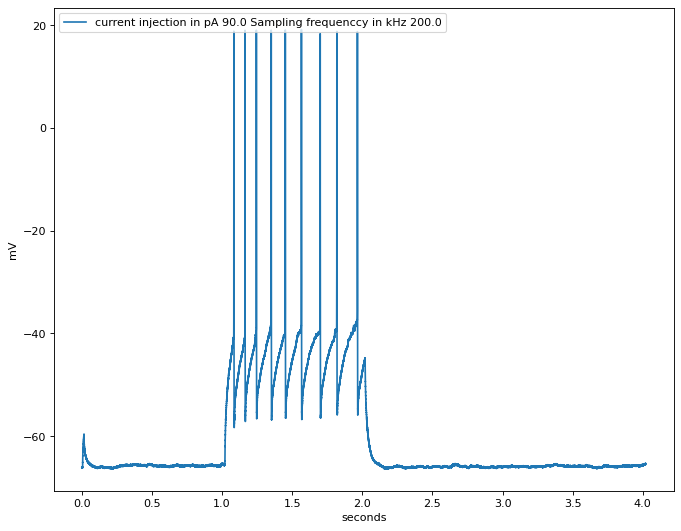

In [ ]:

(t,v_data,st,rsv,v_model,t_model) = get_sweep(sweep_number = 31) 

In [ ]:
data = []
data.append(go.Scatter(x=rsv,y=v_model))
data.append(go.Scatter(x=t,y=v_data))
fig = go.Figure(data = data)
for i in st:
  fig.add_vline(x=i, line_width=3, line_dash="solid", line_color="blue")
fig.show()


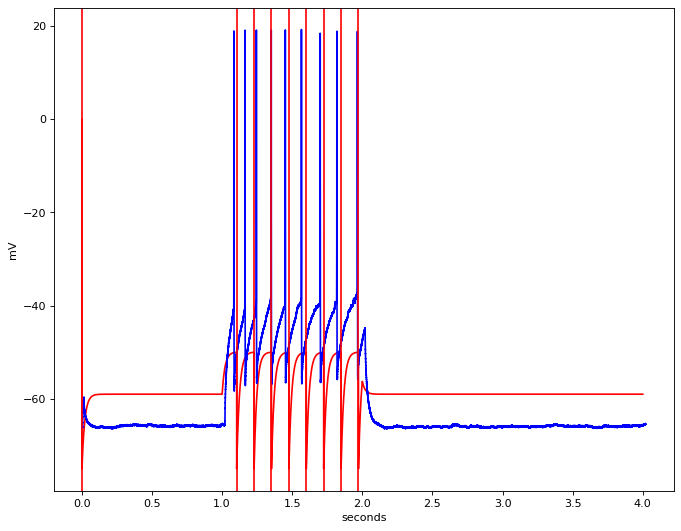

In [ ]:
fig, axes = plt.subplots(1, 1, sharex=True,figsize=(10, 8), dpi=80)

plt.plot(rsv,v_model,c='red',label="LIF model experiment")
plt.plot(t, v_data, color='blue',label="Mouse electrode ephys experimental data")
axes.set_ylabel("mV")
axes.set_xlabel("seconds")
for i in st:
  plt.axvline(i,c='red')

fig.show()



# Question
<summary> Which trace is biological, which trace is modelled? </summary>

<details>
  Blue is biological as it can contains high frequency noise in the below threshold part of the trace.
</details>

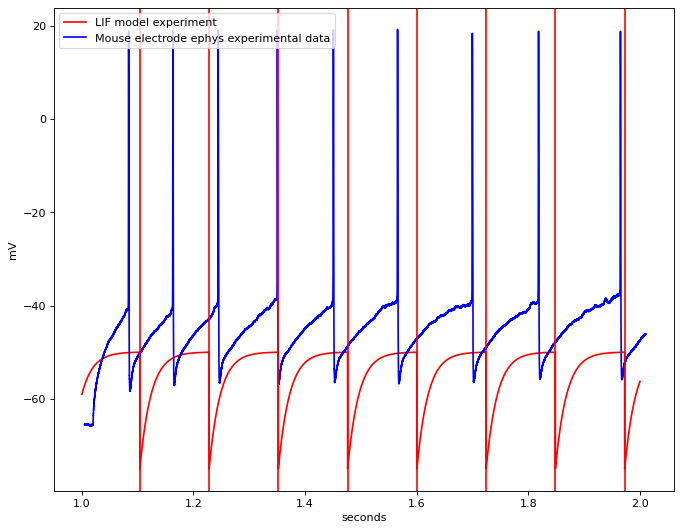

In [ ]:
fig, axes = plt.subplots(1, 1, sharex=True,figsize=(10, 8), dpi=80)

plt.plot(rsv[int(len(v_model)/4.0):int(len(v_model)/2.0)],v_model[int(len(v_model)/4.0):int(len(v_model)/2.0)],c='red',label="LIF model experiment")
plt.plot(t[int(len(v_data)/4.0):int(len(v_data)/2.0)], v_data[int(len(v_data)/4.0):int(len(v_data)/2.0)], color='blue',label="Mouse electrode ephys experimental data")
axes.set_ylabel("mV")
axes.set_xlabel("seconds")
for i in st[1:]:
  plt.axvline(i,c='red')
plt.legend(loc="upper left")

fig.show()

data = []
data.append(go.Scatter(x=rsv[int(len(v_model)/4.0):int(len(v_model)/2.0)],y=v_model[int(len(v_model)/4.0):int(len(v_model)/2.0)],))
data.append(go.Scatter(x=t[int(len(v_data)/4.0):int(len(v_data)/2.0)],y=v_data[int(len(v_data)/4.0):int(len(v_data)/2.0)]))

fig = go.Figure(data = data)
for i in st[1:]:
  fig.add_vline(x=i, line_width=3, line_dash="solid", line_color="blue")

fig.show()




## This Does not Matter for the Network Level Computations
# End of Tutorial.
## Are there any questions?



* The plot compares the trace of a Leaky Integrate and Fire Neuron model (red) against real ephys data collected from a rodent (blue). 

* What metrics could you use to quantify the agreement/dis-agreement between the two?

* Do you think the agreement is acceptable?

* What is the least realistic part of the LIF $V_{m}$ shape?

* What should be the real units of $V_{m}$?

* What should be the the real resting membrane potential $V_{R}$?

<!---
![](https://github.com/russelljjarvis/LIF_DE_Brian2/blob/main/other_lecture/LIF_vs_HH.png?raw=1)
-->
### Fitting to data.

* the Action Potential shape may still disagree with data in all of these ways: